# Exploratory Spatial Data Analysis: Spatial Autocorrelation

- Spatial Weights and adjacency matrices

- **Spatial Autocorrelation**

- Moran Plot

- Moran's I Statistic

- Global and local spatial autocorrelation


Adapted partially from:

- https://geographicdata.science/book/notebooks/04_spatial_weights.html
- https://pysal.org/libpysal/notebooks/weights.html#Contiguity-Weights

See also `libpysal` API documentation: https://pysal.org/libpysal/api.html

#### Also introducing `pysal`, the Python Spatial Analysis Library

In [174]:
#We'll need this:

from libpysal import weights

In [175]:
#Plus geopandas and our other standard libraries
#####

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import geopandas as gpd

In [176]:
#And suppress warnings for cleanliness
import warnings
warnings.filterwarnings("ignore")

Let's start with **adjacency matrices**, which we will need to define how spatial objects neighbor each other...

<br>

In [177]:
#Make a grid of polygons for demonstration purposes
#######

from shapely.geometry import Polygon

polygon_list = []

# Generate polygons
for y in range(0,3): #range(3,0,-1):
    for x in range(4):
        square = Polygon([(x, y), (x + 1, y), (x + 1, y + 1), (x, y + 1)])
        polygon_list.append(square)
        
#GeoSeries:
poly_Series = gpd.GeoSeries(polygon_list)


<AxesSubplot: >

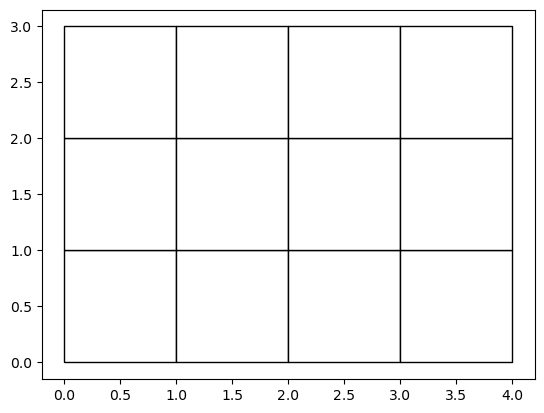

In [179]:
#Can plot our GeoSeries:
poly_Series.plot(facecolor='white', edgecolor='black')

In [180]:
#Can embed in a GeoDataFrame:
########

#Add a name that's just sequential numbers
name = [i for i in range(len(poly_Series))]

gdf = gpd.GeoDataFrame({"name":name, "geometry": poly_Series})

#Also, add the centroid to each:
gdf['centroid'] = gdf.centroid

In [185]:
#Note extracting the x and y values:
gdf.centroid.iloc[0].x

0.5

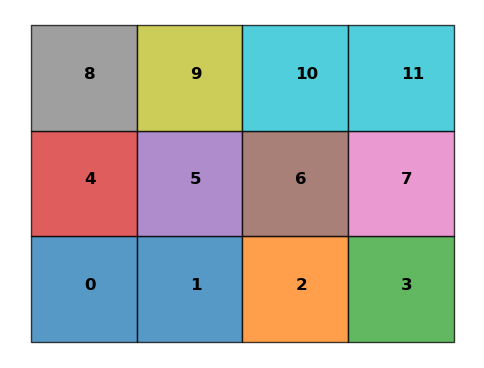

In [186]:
#Plot our polygon matrix:
######

fig1, ax1 = plt.subplots(1,1, figsize=(6, 6))

gdf.plot(edgecolor='black', column='name', categorical = True, ax=ax1, alpha=.75)


#Add the name label
for k in range(len(gdf)):
    ax1.text(gdf.centroid.iloc[k].x, gdf.centroid.iloc[k].y, str(gdf.iloc[k].name), fontweight='bold', fontsize=12)


ax1.set_axis_off()

### Contiguity/Adjacency Matrix:

#### Rook Adjacency

<img src="rook_moves2.png" width=150 />

Figure due to Wikipedia

In [187]:
#Get rook contiguity matrix:
#######

weights_rook = weights.contiguity.Rook.from_dataframe(gdf)
weights_rook

{0: [1, 4],
 1: [0, 2, 5],
 2: [1, 3, 6],
 3: [2, 7],
 4: [0, 8, 5],
 5: [1, 4, 6, 9],
 6: [2, 10, 5, 7],
 7: [3, 11, 6],
 8: [9, 4],
 9: [8, 10, 5],
 10: [9, 11, 6],
 11: [10, 7]}

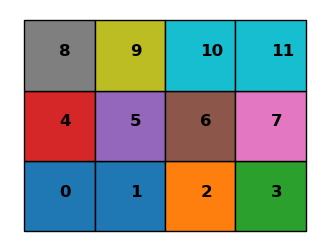

In [188]:
#We get neighbors:
display(weights_rook.neighbors)

#Plot again to compare
fig1, ax1 = plt.subplots(1,1, figsize=(4, 4))
gdf.plot(edgecolor='black', column='name', categorical = True, ax=ax1)


#Add the name label
for k in range(len(gdf)):
    ax1.text(gdf.centroid.iloc[k].x, gdf.centroid.iloc[k].y, str(gdf.iloc[k].name), fontweight='bold', fontsize=12)


ax1.set_axis_off()

In [189]:
#And weights are just
############

weights_rook.weights

{0: [1.0, 1.0],
 1: [1.0, 1.0, 1.0],
 2: [1.0, 1.0, 1.0],
 3: [1.0, 1.0],
 4: [1.0, 1.0, 1.0],
 5: [1.0, 1.0, 1.0, 1.0],
 6: [1.0, 1.0, 1.0, 1.0],
 7: [1.0, 1.0, 1.0],
 8: [1.0, 1.0],
 9: [1.0, 1.0, 1.0],
 10: [1.0, 1.0, 1.0],
 11: [1.0, 1.0]}

In [190]:
#Interested in plotting
#Note:
help(weights_rook.plot)

Help on method plot in module libpysal.weights.weights:

plot(gdf, indexed_on=None, ax=None, color='k', node_kws=None, edge_kws=None) method of libpysal.weights.contiguity.Rook instance
    Plot spatial weights objects. **Requires** ``matplotlib``, and
    implicitly requires a ``geopandas.GeoDataFrame`` as input.
    
    Parameters
    ----------
    gdf : geopandas.GeoDataFrame
        The original shapes whose topological relations are modelled in ``W``.
    indexed_on : str
        Column of ``geopandas.GeoDataFrame`` that the weights object uses
        as an index. Default is ``None``, so the index of the
        ``geopandas.GeoDataFrame`` is used.
    ax : matplotlib.axes.Axes
        Axis on which to plot the weights. Default is ``None``, so
        plots on the current figure.
    color : str
        ``matplotlib`` color string, will color both nodes and edges
        the same by default.
    node_kws : dict
        Keyword arguments dictionary to send to ``pyplot.scatter``,


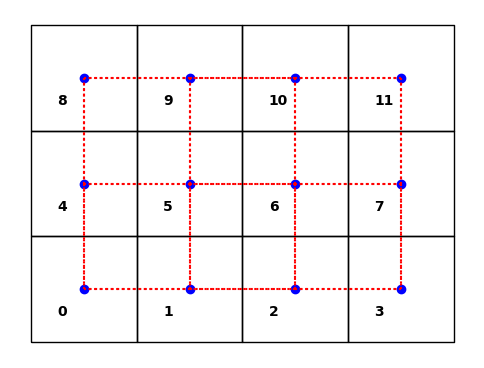

In [191]:
# Plot results:
##
fig1, ax1 = plt.subplots(1,1, figsize=(6, 6))

gdf.plot(edgecolor='black', facecolor='none', ax=ax1)

for k in range(len(gdf)):
    #Offset x and y a little:
    ax1.text(gdf.centroid.iloc[k].x-.25, gdf.centroid.iloc[k].y-.25, str(gdf.iloc[k].name), fontweight='bold')
    
#Adjacency matrix
weights_rook.plot(gdf, color='b', edge_kws=dict(color="r", linestyle=':'), ax=ax1)

ax1.set_axis_off()

In [192]:
#Can get full matrix representation as well:
#####

weights_rook.full()

(array([[0., 1., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 1., 0., 0., 1., 0., 0., 0., 0., 0., 0.],
        [0., 1., 0., 1., 0., 0., 1., 0., 0., 0., 0., 0.],
        [0., 0., 1., 0., 0., 0., 0., 1., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 1., 0., 0., 1., 0., 0., 0.],
        [0., 1., 0., 0., 1., 0., 1., 0., 0., 1., 0., 0.],
        [0., 0., 1., 0., 0., 1., 0., 1., 0., 0., 1., 0.],
        [0., 0., 0., 1., 0., 0., 1., 0., 0., 0., 0., 1.],
        [0., 0., 0., 0., 1., 0., 0., 0., 0., 1., 0., 0.],
        [0., 0., 0., 0., 0., 1., 0., 0., 1., 0., 1., 0.],
        [0., 0., 0., 0., 0., 0., 1., 0., 0., 1., 0., 1.],
        [0., 0., 0., 0., 0., 0., 0., 1., 0., 0., 1., 0.]]),
 [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11])

#### Queen Adjacency

Consider adjacent if share a single vertex:

<img src="queen_moves2.png" width=150 />

Figure due to Wikipedia

In [193]:
#And get queen contiguity matrix:
#######

weights_queen = weights.contiguity.Queen.from_dataframe(gdf)

In [194]:
#We get neighbors:
weights_queen.neighbors

{0: [1, 4, 5],
 1: [0, 2, 4, 5, 6],
 2: [1, 3, 5, 6, 7],
 3: [2, 6, 7],
 4: [0, 1, 5, 8, 9],
 5: [0, 1, 2, 4, 6, 8, 9, 10],
 6: [1, 2, 3, 5, 7, 9, 10, 11],
 7: [2, 3, 6, 10, 11],
 8: [9, 4, 5],
 9: [4, 5, 6, 8, 10],
 10: [5, 6, 7, 9, 11],
 11: [10, 6, 7]}

In [195]:
#Also note cardinalities:
####

weights_queen.cardinalities

{0: 3, 1: 5, 2: 5, 3: 3, 4: 5, 5: 8, 6: 8, 7: 5, 8: 3, 9: 5, 10: 5, 11: 3}

In [196]:
#Extract as list:
list(weights_queen.cardinalities.values())

[3, 5, 5, 3, 5, 8, 8, 5, 3, 5, 5, 3]

In [197]:
#Can add to cardinalities into the gdf:
######

gdf['card'] = list(weights_queen.cardinalities.values())

#Alternative:
#gdf = gdf.assign(card=list(weights_queen.cardinalities.values()))

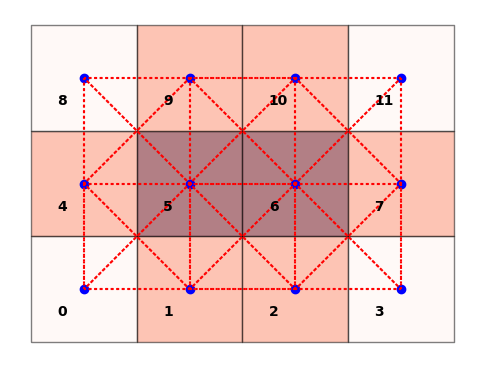

In [199]:
# Plot results:
##
fig1, ax1 = plt.subplots(1,1, figsize=(6, 6))

#Color by cardinality
gdf.plot(edgecolor='black', column = 'card', cmap='Reds', alpha=.5, ax=ax1)

for k in range(len(gdf)):
    #Offset x and y a little:
    ax1.text(gdf.centroid.iloc[k].x-.25, gdf.centroid.iloc[k].y-.25, str(gdf.iloc[k].name), fontweight='bold')
    
weights_queen.plot(gdf, color='b', edge_kws=dict(color="r", linestyle=':'), ax=ax1)

ax1.set_axis_off()

### K-Nearest Neighbors

In [210]:
#And KNN matrix:
#######

weights_KNN = weights.distance.KNN.from_dataframe(gdf, k=5)

In [211]:
weights_KNN.neighbors

{0: [4, 1, 5, 2, 8],
 1: [2, 0, 5, 6, 4],
 2: [6, 1, 3, 5, 7],
 3: [7, 2, 6, 1, 11],
 4: [8, 0, 5, 9, 1],
 5: [9, 1, 4, 6, 8],
 6: [10, 2, 7, 5, 11],
 7: [11, 3, 6, 10, 2],
 8: [9, 4, 5, 10, 0],
 9: [10, 8, 5, 6, 4],
 10: [9, 6, 11, 5, 7],
 11: [10, 7, 6, 9, 3]}

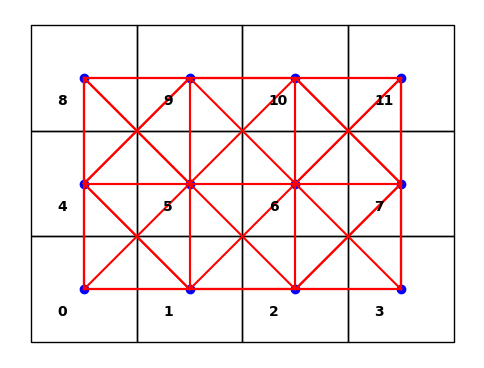

In [212]:
# Plot:
##
fig1, ax1 = plt.subplots(1,1, figsize=(6, 6))

gdf.plot(edgecolor='black', facecolor='none', ax=ax1)

for k in range(len(gdf)):
    #Offset x and y a little:
    ax1.text(gdf.centroid.iloc[k].x-.25, gdf.centroid.iloc[k].y-.25, str(gdf.iloc[k].name), fontweight='bold')
    
weights_KNN.plot(gdf, color='b', edge_kws=dict(color="r", linestyle='-'), ax=ax1)

ax1.set_axis_off()

### Now Let's do on Real Geometry

- First reload Census geometries, etc. from before

- We'll also need the Census demographic data merged in, just as before

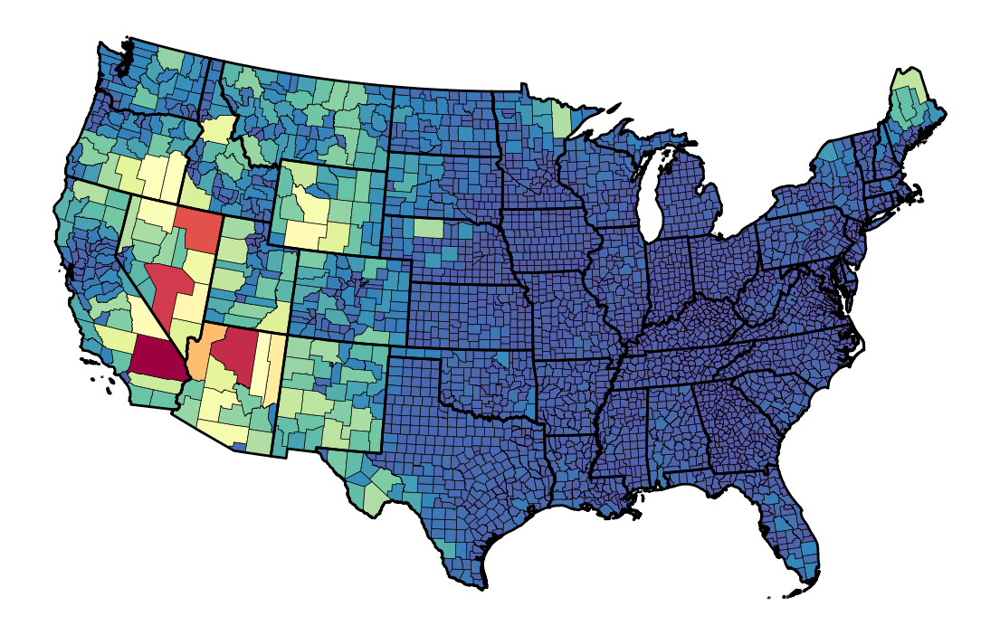

In [213]:
#Let's re-load our county and state geometries from last time
################

#Load the counties and states:
#URLs:
url_county = 'https://www2.census.gov/geo/tiger/GENZ2021/shp/cb_2021_us_county_500k.zip'
url_state = 'https://www2.census.gov/geo/tiger/GENZ2021/shp/cb_2021_us_state_500k.zip'

#Load:
county_gdf = gpd.read_file(url_county)
state_gdf = gpd.read_file(url_state)

## Convert CRS to North American Albers, EPSG 5070
county_gdf = county_gdf.to_crs(5070)
state_gdf = state_gdf.to_crs(5070)

#Restrict to contiguous US
exclude_list = [15, 72, 2, 60, 66, 69, 78]

#~ is not
state_gdf = state_gdf.loc[~state_gdf['STATEFP'].astype(int).isin(exclude_list)]
county_gdf = county_gdf.loc[~county_gdf['STATEFP'].astype(int).isin(exclude_list)]


#Add a FIPS code for the counties
county_gdf['FIPS'] = county_gdf.STATEFP + county_gdf.COUNTYFP


#Quick Check:
##########
fig, ax1 = plt.subplots(1,1, figsize=(14, 10))

#Draw the counties:
county_gdf.plot(ax = ax1, linewidth = .5, edgecolor = 'black', column = 'ALAND', cmap='Spectral_r')

#And the states as outline
state_gdf.plot(ax = ax1, linewidth = 2, edgecolor = 'black', facecolor = 'none')

ax1.set_axis_off()

In [214]:
### Get Census Data
####################

#Here's our URL:
url_name = r'https://www2.census.gov/programs-surveys/popest/datasets/2010-2020/counties/totals/co-est2020-alldata.csv'

#Load
df = pd.read_csv(url_name, encoding = "ISO-8859-1", engine='python')

#Create the FIPS:
df['FIPS'] = df.STATE.astype(str).str.zfill(2) + df.COUNTY.astype(str).str.zfill(3)

#Merge to create gdf_county_all
gdf_county_all = county_gdf.merge(df, left_on='FIPS', right_on='FIPS', how='left')

In [ ]:
### Let's get our weights
### Note:

help(weights.contiguity.Queen.from_dataframe)

In [216]:
#Get Queen Adjacency Matrix
#Note ids:
##########

wq_states = weights.contiguity.Queen.from_dataframe(state_gdf, ids='STATEFP')

In [217]:
#Let's make a dataframe of ids, and associated cardinalities:
wq_states.id_order


['01',
 '04',
 '05',
 '06',
 '08',
 '09',
 '10',
 '11',
 '12',
 '13',
 '16',
 '17',
 '18',
 '19',
 '20',
 '21',
 '22',
 '23',
 '24',
 '25',
 '26',
 '27',
 '28',
 '29',
 '30',
 '31',
 '32',
 '33',
 '34',
 '35',
 '36',
 '37',
 '38',
 '39',
 '40',
 '41',
 '42',
 '44',
 '45',
 '46',
 '47',
 '48',
 '49',
 '50',
 '51',
 '53',
 '54',
 '55',
 '56']

In [218]:
# Add cardinality
df = pd.DataFrame({'STATEFP': wq_states.id_order, 'card':list(wq_states.cardinalities.values())})

In [220]:
state_gdf2 = state_gdf.merge(df, on='STATEFP', how='left')

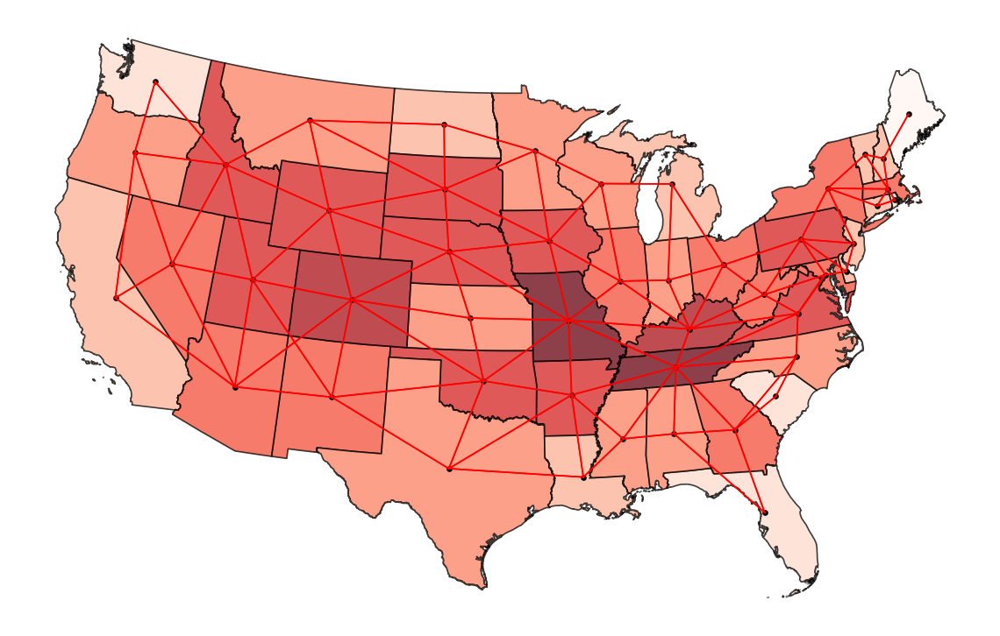

In [221]:
#Plot, color choropleth by cardinality
#############

fig, ax1 = plt.subplots(1,1, figsize=(12, 8), dpi=120)

state_gdf2.plot(ax = ax1, edgecolor = 'black', column = 'card', alpha=.75, cmap='Reds')
wq_states.plot(state_gdf2, indexed_on='STATEFP', node_kws=dict(marker='.'),
                   edge_kws=dict(color="r", linestyle='-', linewidth=1), ax=ax1)

ax1.set_axis_off()

In [172]:
#Same for counties: All together:
#####################

wq_counties = weights.contiguity.Queen.from_dataframe(county_gdf, ids='FIPS')

df = pd.DataFrame({'FIPS': wq_counties.id_order, 'card':list(wq_counties.cardinalities.values())})

county_gdf2 = county_gdf.merge(df, on='FIPS', how='left')

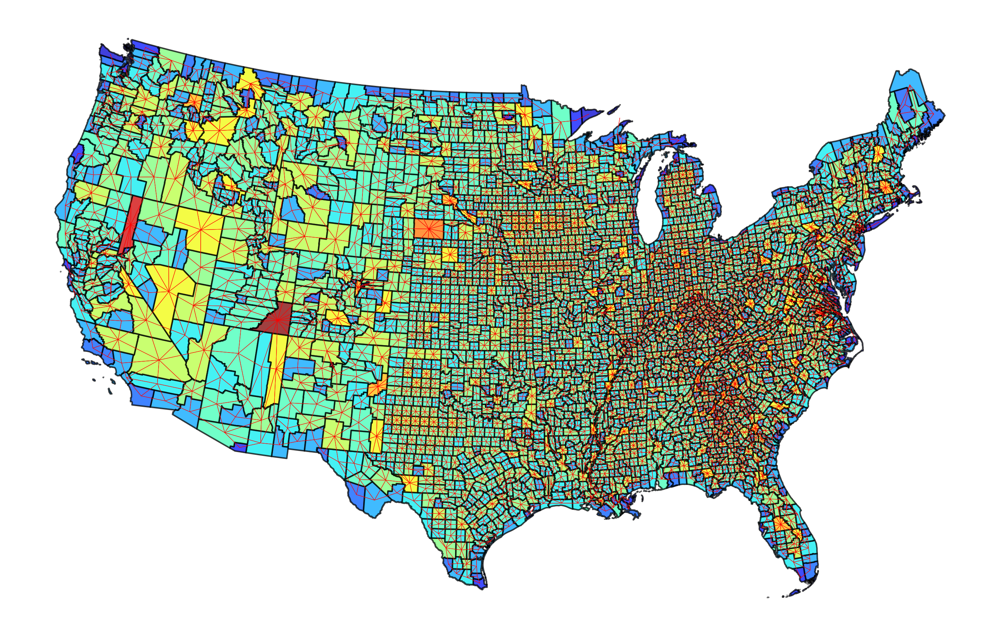

In [173]:
fig, ax1 = plt.subplots(1,1, figsize=(12, 8), dpi=300)

county_gdf2.plot(ax = ax1, edgecolor = 'black', column = 'card', alpha=.75, cmap='jet')

wq_counties.plot(county_gdf2, indexed_on='FIPS', node_kws=dict(marker=''),
                   edge_kws=dict(color="r", linestyle='-', linewidth=.25), ax=ax1)

ax1.set_axis_off()

### K-Nearest Neighbor Weights

In [222]:
wk4 = weights.distance.KNN.from_dataframe(state_gdf, ids='STATEFP', k=4)

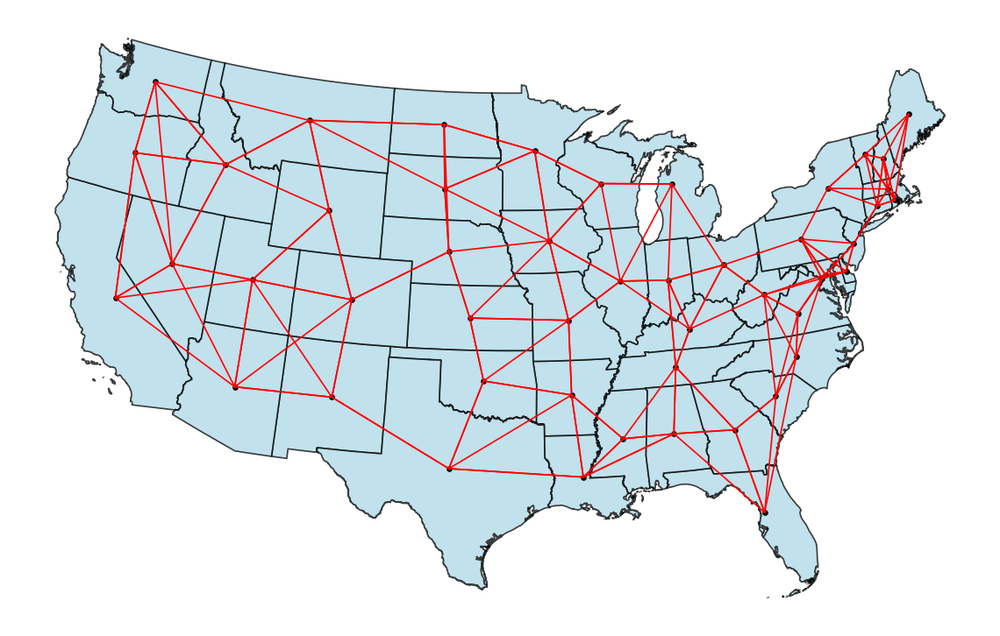

In [223]:
#Plot
#############

fig, ax1 = plt.subplots(1,1, figsize=(12, 8), dpi=120)

state_gdf.plot(ax = ax1, edgecolor = 'black', facecolor='lightblue', alpha=.75)
wk4.plot(state_gdf, indexed_on='STATEFP', node_kws=dict(marker='.'),
                   edge_kws=dict(color="r", linestyle='-', linewidth=1), ax=ax1)

ax1.set_axis_off()

### Kernel Weights

- Takes distance into account...

- Applies a kernel function to determine weight decay with distance. Default is `triangular`

- Other kernel options(`function` argument): `triangular`, `uniform`, `quadratic`, `quartic`, `gaussian`

- Can set max number of neighbors

- For adaptive kernel bandwidth, set `fixed=False`

In [224]:
#Option:
#Set fixed = False for variable bandwidth
#k = KNN. Once we have KNN, no more connections. Ex:

w_kernel = weights.distance.Kernel.from_dataframe(state_gdf, ids='STATEFP', fixed=False, k=5, function='Gaussian')


In [225]:
w_kernel.weights

{'56': [0.3989422804014327,
  0.2934485864304637,
  0.2927541746743595,
  0.2707329667778687,
  0.25086956686371586,
  0.24197074871621344],
 '24': [0.3989422804014327,
  0.39668214664491624,
  0.3619799040470903,
  0.2679189638504031,
  0.26389533951665967,
  0.2419707487162134],
 '05': [0.3989422804014327,
  0.3276607935441772,
  0.31369004429263553,
  0.29657543449262425,
  0.2834543858421331,
  0.2419707487162134],
 '38': [0.3989422804014327,
  0.3607163783416006,
  0.32147014500877374,
  0.26918056043446426,
  0.25665130900620065,
  0.2419707487162134],
 '10': [0.3989422804014327,
  0.37808036263356876,
  0.36917039381272376,
  0.35931637500328595,
  0.2736044550344254,
  0.2419707487162134],
 '35': [0.3989422804014327,
  0.3249776347451577,
  0.3224351836876065,
  0.26639493166922035,
  0.25883684556697345,
  0.2419707487162134],
 '49': [0.3989422804014327,
  0.3143482975008518,
  0.2766297247834885,
  0.27226532844317686,
  0.26190302932441983,
  0.2419707487162134],
 '54': [0.3

In [226]:
w_kernel.neighbors

{'56': ['56', '08', '30', '49', '16', '46'],
 '24': ['24', '11', '10', '34', '42', '51'],
 '05': ['05', '28', '29', '22', '40', '47'],
 '38': ['38', '46', '27', '31', '30', '56'],
 '10': ['10', '24', '11', '34', '42', '51'],
 '35': ['35', '04', '08', '48', '49', '40'],
 '49': ['49', '32', '08', '56', '04', '16'],
 '54': ['54', '51', '39', '11', '24', '42'],
 '20': ['20', '40', '31', '29', '19', '08'],
 '13': ['13', '45', '01', '47', '12', '37'],
 '28': ['28', '01', '22', '05', '47', '13'],
 '27': ['27', '55', '19', '38', '46', '31'],
 '33': ['33', '50', '25', '44', '09', '23'],
 '29': ['29', '17', '05', '19', '20', '40'],
 '16': ['16', '41', '30', '53', '32', '56'],
 '46': ['46', '31', '38', '27', '19', '56'],
 '42': ['42', '24', '11', '34', '10', '36'],
 '40': ['40', '20', '05', '48', '29', '31'],
 '18': ['18', '17', '21', '39', '47', '26'],
 '34': ['34', '10', '24', '09', '11', '42'],
 '31': ['31', '46', '20', '19', '08', '56'],
 '08': ['08', '56', '35', '49', '31', '20'],
 '36': ['3

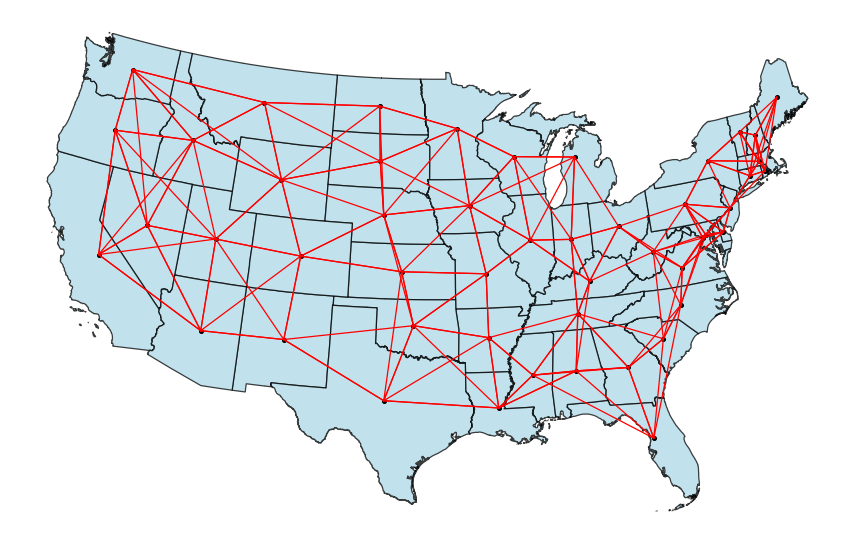

In [227]:
#Plot
#############

fig, ax1 = plt.subplots(1,1, figsize=(12, 8), dpi=90)

state_gdf.plot(ax = ax1, edgecolor = 'black', facecolor='lightblue', alpha=.75)
w_kernel.plot(state_gdf, indexed_on='STATEFP', node_kws=dict(marker='.'),
                   edge_kws=dict(color="r", linestyle='-', linewidth=1), ax=ax1)

ax1.set_axis_off()

### Distance Bands

- Find all polygons within a specified radius

- Can optionally allow continuous weighting

In [233]:
#binary=True means don't use continuous weighting

w_db = weights.distance.DistanceBand.from_dataframe(state_gdf, 9e5, binary=True, ids='STATEFP')

In [234]:
w_db.weights

{'56': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '24': [1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0],
 '05': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '38': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '10': [1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0],
 '35': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '49': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '54': [1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0,
  1.0],
 '20': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '13': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '28': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '27': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '33': [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 '29': [1.0,
  1.0,

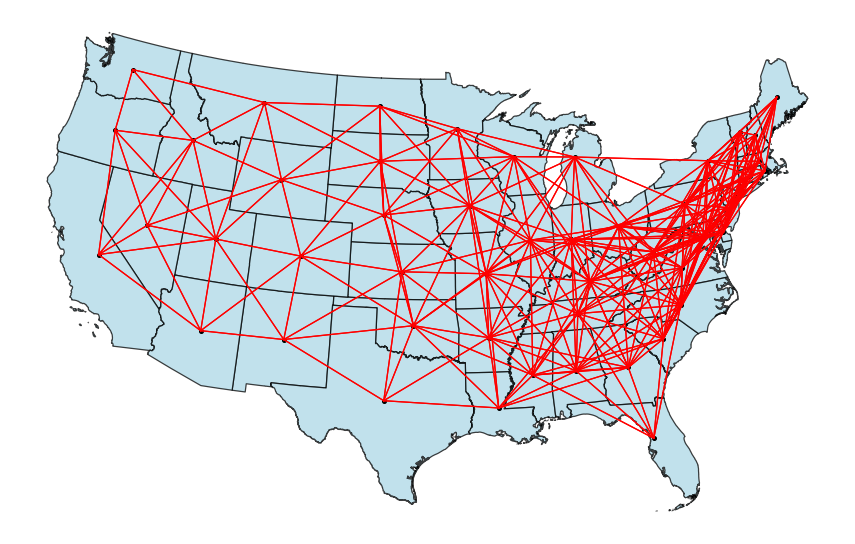

In [230]:
#Plot once again
#############

fig, ax1 = plt.subplots(1,1, figsize=(12, 8), dpi=90)

state_gdf.plot(ax = ax1, edgecolor = 'black', facecolor='lightblue', alpha=.75)
w_db.plot(state_gdf, indexed_on='STATEFP', node_kws=dict(marker='.'),
                   edge_kws=dict(color="r", linestyle='-', linewidth=1), ax=ax1)

ax1.set_axis_off()

### Block Weights

- Everything within a block is connected

In [235]:
#Grab a subset of counties to demonstrate:
#Just some southwest states, AZ, NM, NV, UT

FP_list = ['04', '35', '32', '49']

sw_county_gdf = county_gdf.loc[county_gdf['STATEFP'].isin(FP_list)]
sw_state_gdf = state_gdf.loc[state_gdf['STATEFP'].isin(FP_list)]

In [236]:
w_bw = weights.util.block_weights(sw_county_gdf['STATEFP'].values,
                                  ids=sw_county_gdf['FIPS'].values)

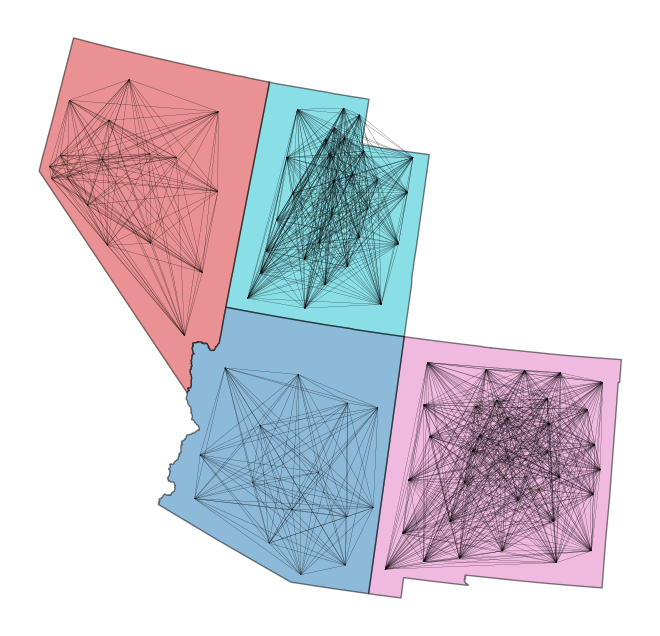

In [238]:
#Plot the block weights
#############

fig, ax1 = plt.subplots(1,1, figsize=(12, 8))

sw_state_gdf.plot(ax = ax1, edgecolor = 'black', column='STATEFP', alpha=.5)

w_bw.plot(sw_county_gdf, indexed_on='FIPS', node_kws=dict(marker=''),
                   edge_kws=dict(color="k", linestyle='-', linewidth=.1, alpha=.75), ax=ax1)

ax1.set_axis_off()

### Union Two Weighting Schemes

For example...

In [239]:
#Kernel
w_kernel = weights.distance.Kernel.from_dataframe(sw_county_gdf, ids='FIPS', fixed=False, k=10)

#Plus block weights
w_bw = weights.util.block_weights(sw_county_gdf['STATEFP'].values,
                                  ids=sw_county_gdf['FIPS'].values)

w_union = weights.set_operations.w_union(w_kernel, w_bw)

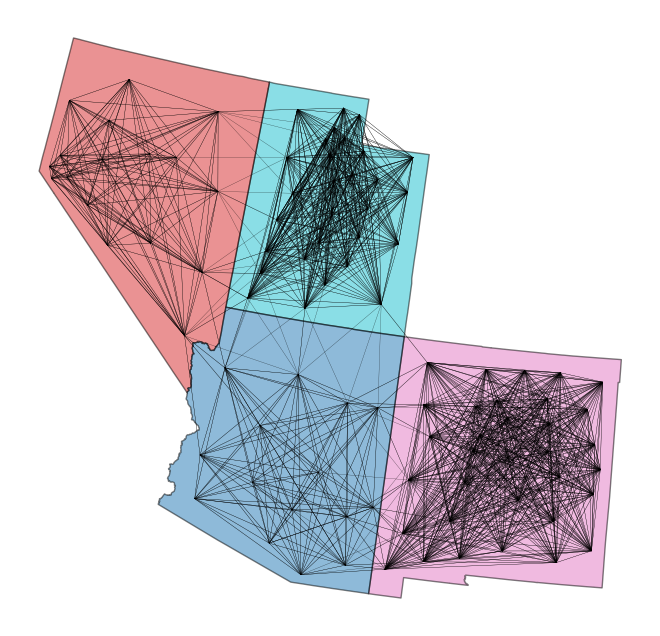

In [240]:
#Plot the result
#############

fig, ax1 = plt.subplots(1,1, figsize=(12, 8))

sw_state_gdf.plot(ax = ax1, edgecolor = 'black', column='STATEFP', alpha=.5)

w_union.plot(sw_county_gdf, indexed_on='FIPS', node_kws=dict(marker=''),
                   edge_kws=dict(color="k", linestyle='-', linewidth=.2, alpha=.75), ax=ax1)

ax1.set_axis_off()

## Spatial Autocorrelation: Global

- We can formally assess how spatially non-random a variable is

- This can be done at both global and local scales

- Global: How much spatial clustering is there at a global scale?

We first need the **spatial lag operation**. For a given vector of value $y$, we get $y_{sl}$ as

$$
y_{sl} = W y,
$$

where $W$ is the spatial weight matrix. We can also write

$$
y_{sl-i} = \sum_{j} w_{ij} y_{j}.
$$

For a given $i$, each $w_{ij}$ is zero for non-neighbors, and, under row-standardization, $y_{sl-i}$ becomes a weighted average of the values of all neighbors of element $i$ (and not including element $i$).

Now, the idea is that if this local average of the neighborhood of each observation is correlated with the value of the observations themselves, then there exists spatial autocorrelation.

#### To do this in Python, we:

1. First get out weight matrix (and row-standardize!)

2. Then we can use the `weights.spatial_lag.lag_spatial` function to get our spatial lags.

Let's do this with county population as well as population *density* in 2020...

In [241]:
# Get KNN weights:
#Note now we use gdf_county_all, with our demographic parameters:
#W = weights.KNN.from_dataframe(gdf_county_all, ids='FIPS', k=8)

#Or distance kernel:
W = weights.distance.Kernel.from_dataframe(gdf_county_all, ids='FIPS', fixed=False, k=8)

# Row-standardization
W.transform = "R"

In [242]:
#Calculate Spatial Lag
############

#We'll do 2020 Population

#Let's also do Population density in 2020: in persons per sq km
gdf_county_all['POPDENSITY2020'] = gdf_county_all.POPESTIMATE2020 / gdf_county_all.ALAND * 1e6


In [ ]:
#Variable of interest:

if (0):
    var = 'POPESTIMATE2020'
    var_lag = 'POPESTIMATE2020_lag'
else:
    var = 'POPDENSITY2020'
    var_lag = 'POPDENSITY2020_lag'

In [243]:
#Now actually get lag:
#############

gdf_county_all[var_lag] = weights.spatial_lag.lag_spatial(W, gdf_county_all[var])

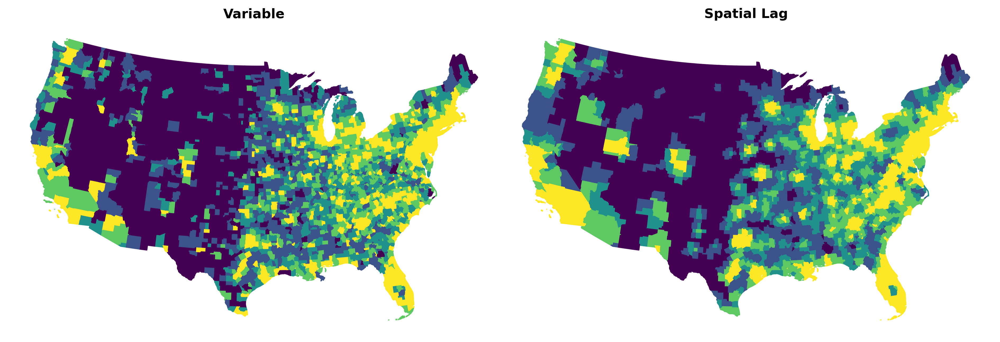

In [244]:
#Plot:
#######

fig1, ax1 = plt.subplots(1,2, figsize=(16, 12), dpi=300)

gdf_county_all.plot(ax=ax1[0], column=var, edgecolor='face', scheme='quantiles', legend=False,
                    legend_kwds={'loc':'lower left'})

gdf_county_all.plot(ax=ax1[1], column=var_lag, edgecolor='face', scheme='quantiles', legend=False,
                    legend_kwds={'loc':'lower left'})

ax1[0].set_title('Variable', fontweight='bold')
ax1[1].set_title('Spatial Lag', fontweight='bold')

ax1[0].set_axis_off()
ax1[1].set_axis_off()

plt.subplots_adjust(wspace=0)

### Moran Plot

- Plot variable of interest against its spatial lag

- Usually normalize variable by subtracting mean: Allows one to interpret correlations in different quadrants

- If significant correlation, then we have good evidence of spatial autocorrelation

- **Moran's I statistic** gives slope of plot

In [246]:
## First let's standardize by subtracting mean:
#########

var_standard = var + '_standard'
var_lag_standard = var_lag + '_standard'

gdf_county_all[var_standard] = gdf_county_all[var] - gdf_county_all[var].mean()

gdf_county_all[var_lag_standard] = gdf_county_all[var_lag] - gdf_county_all[var_lag].mean()

(-100.0, 500.0)

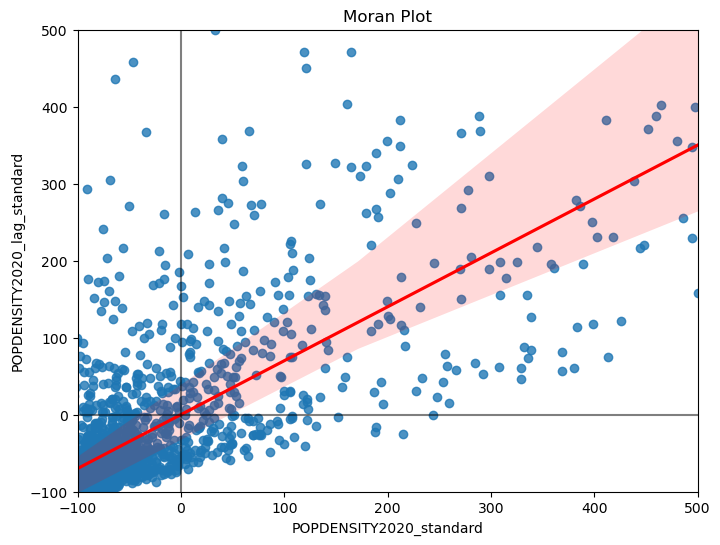

In [247]:
#Plot using seaborn:
import seaborn as sns

fig1, ax1 = plt.subplots(1,1, figsize=(8, 6))


#Include a visual regression
sns.regplot(x=var_standard, y=var_lag_standard, data=gdf_county_all,
            line_kws={"color": "r"}, ax=ax1)

#Vertical lines
ax1.axvline(0, c="k", alpha=0.5)
ax1.axhline(0, c="k", alpha=0.5)

ax1.set_title("Moran Plot")


#Customize our limits to clip outliers if wanted:
ax1.set_xlim([-100, 500]); ax1.set_ylim([-100, 500])
#ax1.set_xlim([-2e5, 3e6]); ax1.set_ylim([-2e5, 3e6])

In [249]:
#And Moran I Statistic: Need esda library
######################
import esda
from splot.esda import plot_moran

moran = esda.moran.Moran(gdf_county_all[var], W)


In [250]:
#Moran's I Statistic?

moran.I

0.699953292788795

In [251]:
#Psuedo p-value?

moran.p_sim

0.001

(<Figure size 1000x400 with 2 Axes>,
 array([<AxesSubplot: title={'center': 'Reference Distribution'}, xlabel='Moran I: 0.7', ylabel='Density'>,
        <AxesSubplot: title={'center': 'Moran Scatterplot (0.7)'}, xlabel='Attribute', ylabel='Spatial Lag'>],
       dtype=object))

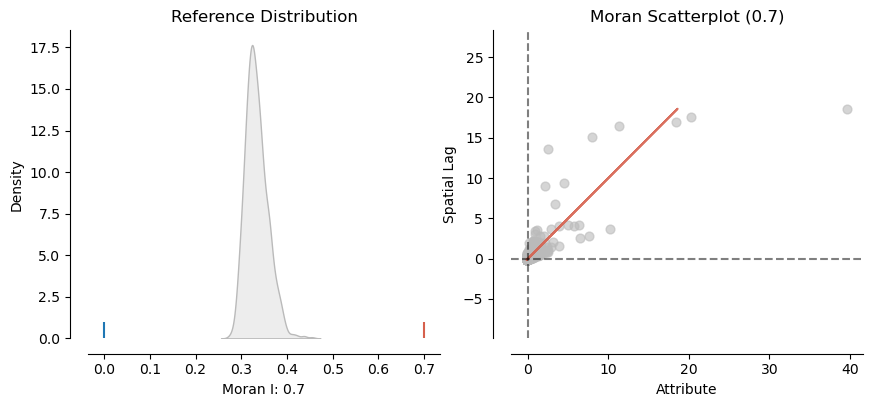

In [252]:
#We have a function, plot_moran, from splot.esda
plot_moran(moran)

### Local Autocorrelation

- Local indicator of spatial autocorrelation (LISA)

- Will use local Moran's I

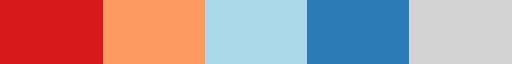

In [253]:
#Make a colormap for use below:
from matplotlib.colors import ListedColormap

vals = [[215/255, 25/255, 28/255],
        [253/255,154/255,97/255],
        [171/255, 217/255, 233/255],
        [44/255, 123/255, 182/255]]

quadrant_cmap = ListedColormap(vals)


vals = [[215/255, 25/255, 28/255],
        [253/255,154/255,97/255],
        [171/255, 217/255, 233/255],
        [44/255, 123/255, 182/255],
        [211/255, 211/255, 211/255]]

quadrant_cmap_wNS = ListedColormap(vals)
quadrant_cmap_wNS

In [254]:
#Recall our KNN weights:
#W = weights.distance.KNN.from_dataframe(gdf_county_all, ids='FIPS', k=4)

#Distance kernel:
W = weights.distance.Kernel.from_dataframe(gdf_county_all, ids='FIPS', fixed=False, k=8)

# Row-standardization
W.transform = "R"

In [255]:
#Re-set our variable of interest:

if (0):
    var = 'POPESTIMATE2020'
    var_lag = 'POPESTIMATE2020_lag'
else:
    var = 'POPDENSITY2020'
    var_lag = 'POPDENSITY2020_lag'

In [256]:
## And standardize again:
#########

var_standard = var + '_standard'
var_lag_standard = var_lag + '_standard'

gdf_county_all[var_standard] = gdf_county_all[var] - gdf_county_all[var].mean()

gdf_county_all[var_lag_standard] = gdf_county_all[var_lag] - gdf_county_all[var_lag].mean()

(-100.0, 500.0)

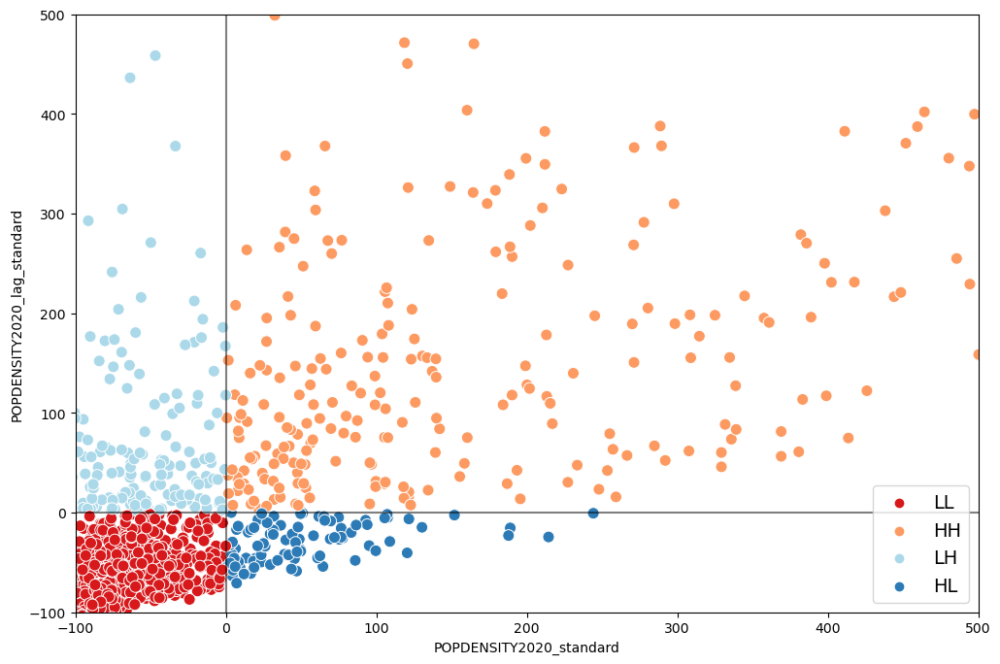

In [258]:
#Consider four possibilities/quadrats in the Moran Plot:
###########

#Code each observation as either HH, HL, LH, or LL
#First is standard, second is lag_standard:

def f(x, y):
    if (x > 0 and y > 0):
        return 'HH'
    elif (x > 0 and y < 0):
        return 'HL'
    elif (x < 0 and y > 0):
        return 'LH'
    else:
        return 'LL'
    
fv = np.vectorize(f)


gdf_county_all['Corr_Type'] = ''
gdf_county_all['Corr_Type'] = fv(gdf_county_all[var_standard], gdf_county_all[var_lag_standard])


fig1, ax1 = plt.subplots(1,1, figsize=(12, 8))

sns.scatterplot(data=gdf_county_all, x=var_standard, y=var_lag_standard,
                hue='Corr_Type', palette=[quadrant_cmap(i) for i in range(4)],
                s=75, ax=ax1);

ax1.axvline(0, c="k", alpha=0.5)
ax1.axhline(0, c="k", alpha=0.5)

ax1.legend(fontsize=14)
#ax1.set_title("Moran Plot")

ax1.set_xlim([-100, 500]); ax1.set_ylim([-100, 500])
#ax1.set_xlim([-2e5, 1e6]); ax1.set_ylim([-2e5, 1e6])
                                                                     

In [259]:
#Get our LISA: Moran Local I
###############

lisa = esda.moran.Moran_Local(gdf_county_all[var], W)

#Local Moran Is:
lisa.Is

array([ 0.01021964,  0.02173668,  0.02230913, ...,  0.01534768,
       -0.00047031,  0.01062975])

In [260]:
#q = 1 HH, 2 LH, 3 LL, 4 HL
lisa.q

array([3, 3, 3, ..., 3, 2, 3])

In [261]:
#Psuedo p value
lisa.p_sim

array([0.085, 0.003, 0.003, ..., 0.001, 0.123, 0.039])

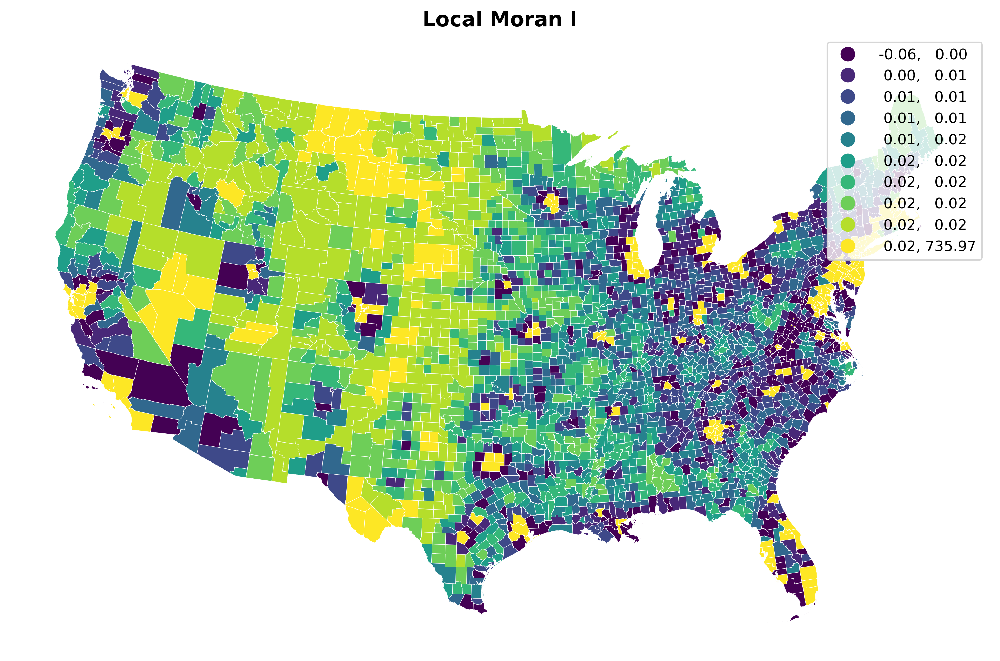

In [262]:
#Several Plots...

fig1, ax1 = plt.subplots(1,1, figsize=(12, 8), dpi=300)

# First: Choropleth of our local statistics
# Add the local statistic (Moran Is) to our geodataframe:

gdf_county_all = gdf_county_all.assign(Is = lisa.Is)

gdf_county_all.plot(column="Is", scheme="quantiles", k=10, linewidth=.25, edgecolor="white", legend=True, ax=ax1)
ax1.set_title('Local Moran I', fontweight='bold', fontsize=14)
ax1.set_axis_off()

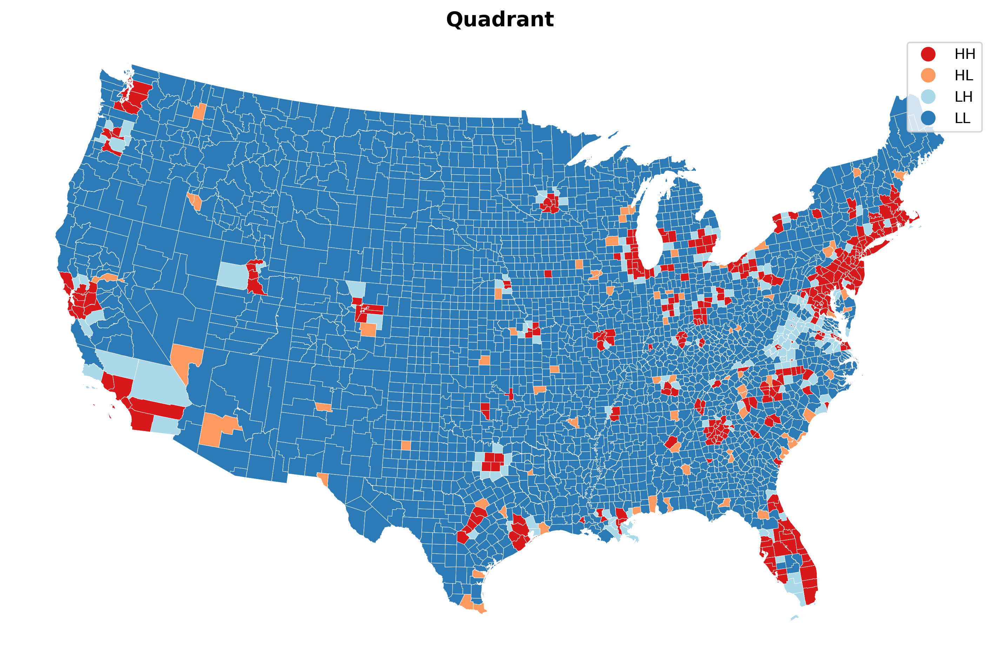

In [263]:
#Get the Quadrants:

def q_to_str(q):
    q_map = ['HH', 'LH', 'LL', 'HL']
    return(q_map[q-1])
    
    
fig1, ax1 = plt.subplots(1,1, figsize=(12, 8), dpi=300)

# Second: Quadrant
gdf_county_all['q'] = lisa.q

#Map to 1 HH, 2 LH, 3 LL, 4 HL
gdf_county_all['q'] = gdf_county_all[['q']].applymap(q_to_str)

gdf_county_all.plot(column="q", linewidth=.25, edgecolor="white", legend=True, ax=ax1, cmap=quadrant_cmap)
ax1.set_title('Quadrant', fontweight='bold', fontsize=14)
ax1.set_axis_off()


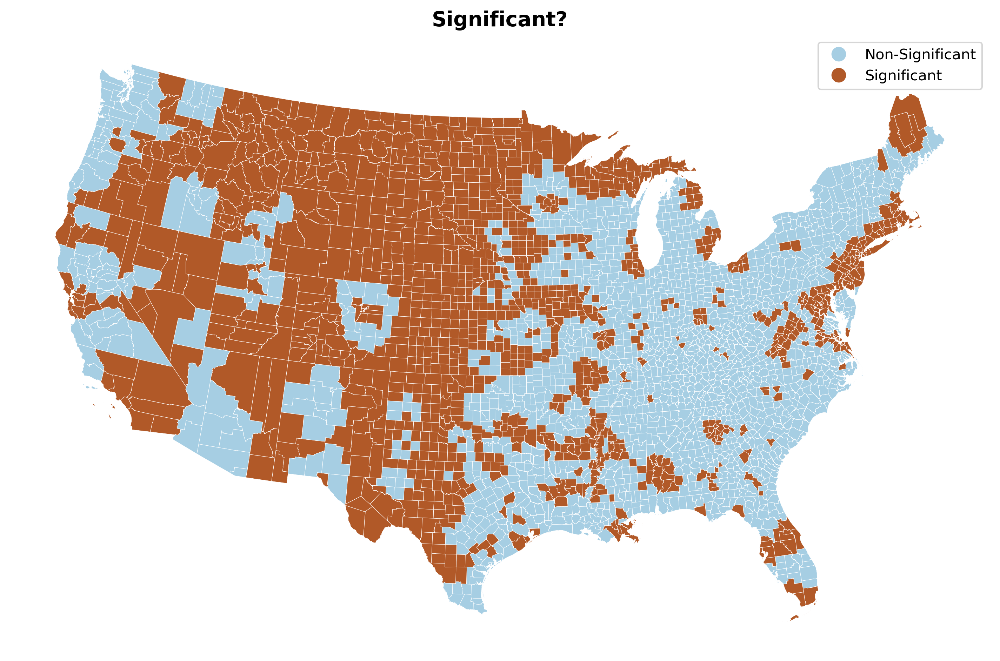

In [264]:
#Where do we meet p < .1?
########

fig1, ax1 = plt.subplots(1,1, figsize=(12, 8), dpi=300)

# Third: Significance
gdf_county_all['p_sim'] = lisa.p_sim
gdf_county_all['p_thresh'] = lisa.p_sim < .1

#Map True/False to strings
gdf_county_all['p_thresh'] = gdf_county_all['p_thresh'].map({True: 'Significant', False:'Non-Significant'})

#Plot:
gdf_county_all.plot(column="p_thresh", linewidth=.25, edgecolor="white", legend=True, ax=ax1, cmap='Paired')
ax1.set_title('Significant?', fontweight='bold', fontsize=14)
ax1.set_axis_off()


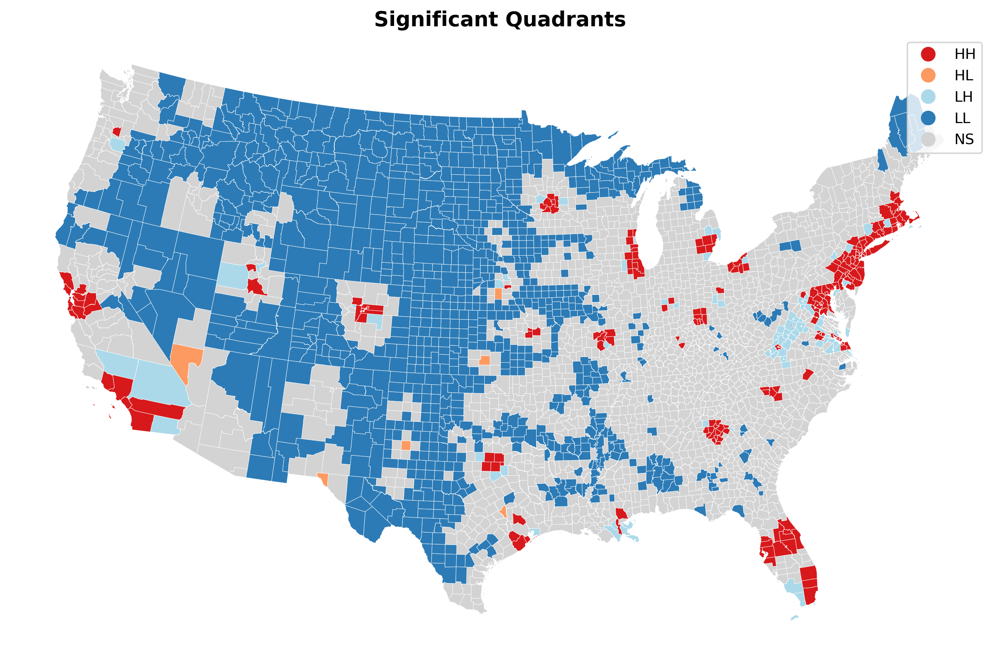

In [265]:
#Quadrants that are significant
########

fig1, ax1 = plt.subplots(1,1, figsize=(12, 8), dpi=300)

gdf_county_all['q_aug'] = gdf_county_all['q']
gdf_county_all['q_aug'].loc[gdf_county_all['p_sim'] > .1] = 'NS'


gdf_county_all.plot(column="q_aug", linewidth=.25, edgecolor="white", legend=True, ax=ax1, cmap=quadrant_cmap_wNS)
ax1.set_title('Significant Quadrants', fontweight='bold', fontsize=14)
ax1.set_axis_off()

(<Figure size 1200x800 with 1 Axes>, <AxesSubplot: >)

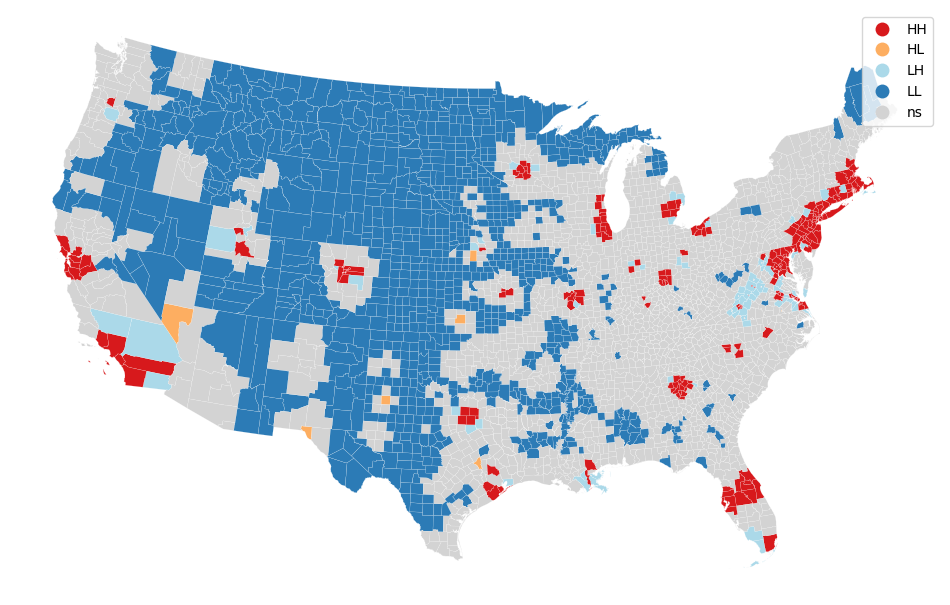

In [266]:
#Built-in Method:
###################

from splot import esda as esdaplot

fig1, ax1 = plt.subplots(1,1, figsize=(12, 8))
esdaplot.lisa_cluster(lisa, gdf_county_all, p=0.1, ax=ax1)

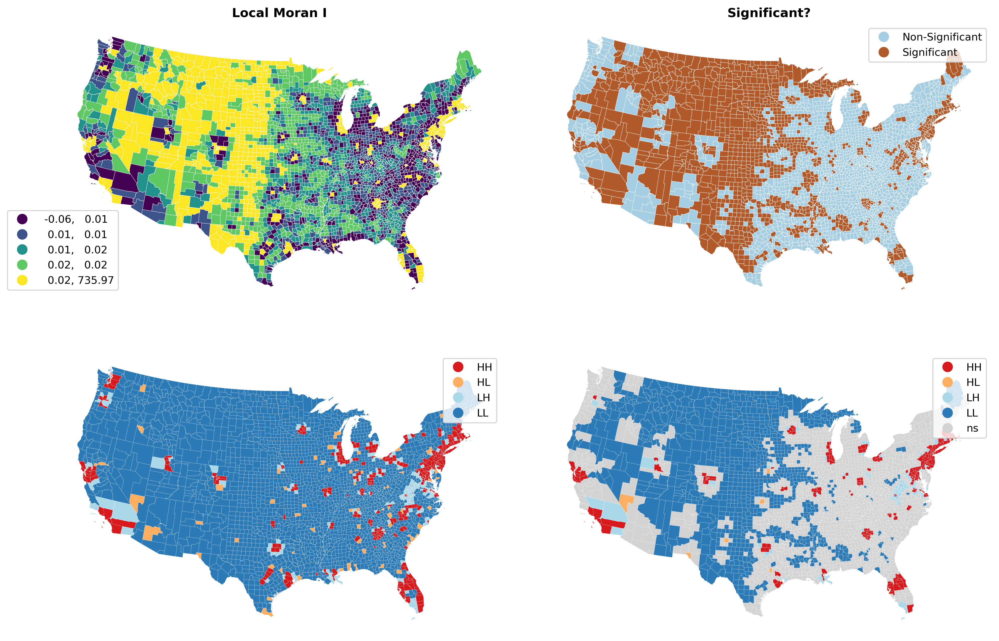

In [267]:
### All together:
##################

fig1, ax1 = plt.subplots(2,2, figsize=(16, 12), dpi=300)

ax1 = ax1.flatten()

#1
gdf_county_all.plot(column="Is", scheme="quantiles", k=5, linewidth=.25, edgecolor="white",
                    legend_kwds={'bbox_to_anchor':(0.15, 0.35)}, legend=True, ax=ax1[0])
ax1[0].set_title('Local Moran I', fontweight='bold', fontsize=12)

#2
gdf_county_all.plot(column="p_thresh", linewidth=.25, edgecolor="white", legend=True, ax=ax1[1], cmap='Paired')
ax1[1].set_title('Significant?', fontweight='bold', fontsize=12)

#3
esdaplot.lisa_cluster(lisa, gdf_county_all, p=1, ax=ax1[2])

#4
esdaplot.lisa_cluster(lisa, gdf_county_all, p=0.1, ax=ax1[3])


for k in range(4):
    ax1[k].set_axis_off()
    
plt.subplots_adjust(hspace=-.1, wspace=0.1)

### Example: Does Death Rate Cluster?

We can quickly adapt the above code...

In [268]:
#KNN weights:
W = weights.distance.KNN.from_dataframe(gdf_county_all, ids='FIPS', k=8)

#Distance kernel:
#W = weights.distance.Kernel.from_dataframe(gdf_county_all, ids='FIPS', fixed=False, k=8)

# Row-standardization
W.transform = "R"

0.39437776915093714

0.001

(<Figure size 1000x400 with 2 Axes>,
 array([<AxesSubplot: title={'center': 'Reference Distribution'}, xlabel='Moran I: 0.39', ylabel='Density'>,
        <AxesSubplot: title={'center': 'Moran Scatterplot (0.39)'}, xlabel='Attribute', ylabel='Spatial Lag'>],
       dtype=object))

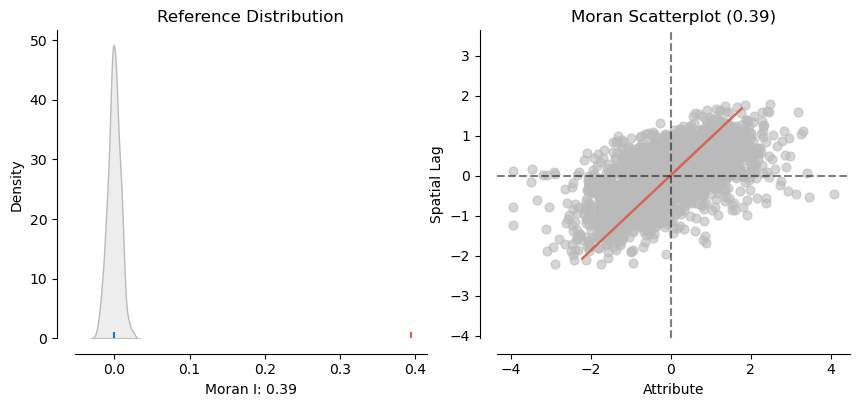

In [269]:
#Global Autocorrelation:

moran = esda.moran.Moran(gdf_county_all["RDEATH2020"], W)

display(moran.I)
display(moran.p_sim)

plot_moran(moran)

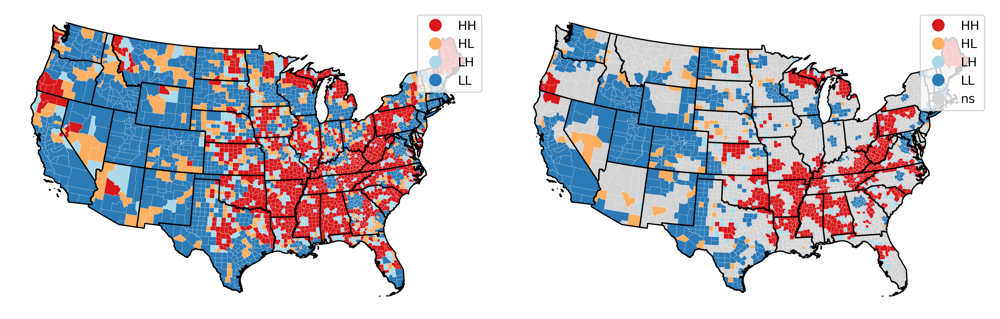

In [270]:
#Get our LISA: Moran Local I
###############

lisa = esda.moran.Moran_Local(gdf_county_all["RDEATH2020"], W)

#And plot everything vs everything significant at p < .1
fig1, ax1 = plt.subplots(1,2, figsize=(14, 8), dpi=300)

esdaplot.lisa_cluster(lisa, gdf_county_all, p=1, ax=ax1[0])
state_gdf.plot(ax=ax1[0], facecolor='none', edgecolor='black')

esdaplot.lisa_cluster(lisa, gdf_county_all, p=0.1, ax=ax1[1])
state_gdf.plot(ax=ax1[1], facecolor='none', edgecolor='black')

plt.subplots_adjust(wspace=0.05)